<a href="https://colab.research.google.com/github/JuanPabloMonDi/Neural-network-for-brain-tumors/blob/main/Redes_Neuronales_Convolucionales.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Redes neuronales convolucionales para imagenes del MR del cérebro

In [ ]:
!pip install visualkeras
import torch
import torch.nn as nn
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt #para graficos
import os #Para tener acceso a las url y vainas asi xd
import cv2 #OpenCV para visualizacion de imagenes
import glob #Esto es para manipular los archivos
from io import BytesIO #se supone, para descomprimir zips
from PIL import Image #Otro paquete para imagenes
import pandas as pd #Creo que todos conocemos pandas xd
from matplotlib.colors import LinearSegmentedColormap, Normalize
import skimage
import keras as kr
import random
#from IPython.display import Image
from PIL import Image
from google.colab import files
import pylab as pl
from skimage import io
from sklearn.model_selection import train_test_split
import seaborn as sns
import visualkeras
import time
%load_ext tensorboard

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.0/993.0 kB 7.9 MB/s eta 0:00:00


### Intento FALLIDO de importar las imagenes

Este fue mi primer acercamiento para tratar de importar las imagenes a este google colab.

La idea era la siguiente:


1.   Subir las imagenes en un archivo zip al colab (para que no fuera tan pesado y así no se demorara tanto)
2.   Descomprimir el archivo en el googlecolab y así, tener las imagenes.

Para esto intenté por medio del siguiente código pero no supe qué hacer despues.

La funcion $\texttt{files_upload()}$ les va pedir que seleccionen el archivo a subir.

El problema que tuve es que no supe como descomprimir el archivo y tener acceso a las imagenes.

Escribo esto poeque quizás alguno de ustedes logre corregirlo y obtenga un código más fácil que el que voy a mostrar


In [ ]:
from google.colab import files
#uploaded = files.upload()

## Importar imagenes desde Google Drive

Según internet, hay varias formas de importar archivos de google drive a colab pero tuve resto de complicaciones, y este método que utilizé es rápido y creo que efectivo.

### 1. Conectar nuestra cuenta de google a google colab

Para poder importar las imagenes, primero debemos concederle acceso a google colab a nuestro google drive. Para eso, utilizamos el siguiente código.


OJO!: No sé si al darle acceso a este colab, los demás miembros tengan acceso al google drive de cada uno (segun leí en las vainas de Google, no es así) pero en caso de que ocurra, por favor respetemos la privacidad de los demas 🥰

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


### Obtener el camino (path) de cada imagen

Una vez le otorgamos el acceso a Google colab, debemos especificar que archivos vamos a subir, para esto debemos hacer lo siguiente:

1. Google Colab NO IMPORTA ARCHIVOS DE CARPETAS "COMPARTIDOS CONMIGO", para arreglar esto, debemos añadir un acceso directo a nuestro drive privado de la siguiente forma, seleccionen la carpeta, le dan click derecho y escogen la opción "Añadir atajo/acceso directo"
2. Obtenemos los archivos formato .jpg (imagen) por medio del comando $\texttt{glob.glob()}$ (ver el siguiente código).

Yo puse el atajo justo al inicio de mi google drive, en caso de que ustedes usen un camino distinto, deben modificar el código de abajo

In [ ]:
Entrenamiento_si=glob.glob("drive/MyDrive/Modelos predictivos para enfermedades /Base de datos Cerebro- Kaggle/Entrenamiento/yes/*.jpg")
Entrenamiento_no=glob.glob("drive/MyDrive/Modelos predictivos para enfermedades /Base de datos Cerebro- Kaggle/Entrenamiento/no/*.jpg")

In [ ]:
prueba_si=glob.glob("drive/MyDrive/Modelos predictivos para enfermedades /Base de datos Cerebro- Kaggle/Prueba/Yes/*.jpg")
prueba_no=glob.glob("drive/MyDrive/Modelos predictivos para enfermedades /Base de datos Cerebro- Kaggle/Prueba/No/*.jpg")

In [ ]:
paths_si=Entrenamiento_si+prueba_si
paths_no=Entrenamiento_no+prueba_no

Podemos ver que "paths_si" contiene las direcciones de cada una de las imagenes de la carpeta "yes" (imagenes del cerebro con tumor).

In [ ]:
paths_si[0:5] #primeros 5 elementos

['drive/MyDrive/Modelos predictivos para enfermedades /Base de datos Cerebro- Kaggle/Entrenamiento/yes/Y108.jpg',
 'drive/MyDrive/Modelos predictivos para enfermedades /Base de datos Cerebro- Kaggle/Entrenamiento/yes/Y105.jpg',
 'drive/MyDrive/Modelos predictivos para enfermedades /Base de datos Cerebro- Kaggle/Entrenamiento/yes/Y101.jpg',
 'drive/MyDrive/Modelos predictivos para enfermedades /Base de datos Cerebro- Kaggle/Entrenamiento/yes/Y102.jpg',
 'drive/MyDrive/Modelos predictivos para enfermedades /Base de datos Cerebro- Kaggle/Entrenamiento/yes/Y104.jpg']

Podemos utilizar la funcion $\texttt{cv2.read()}$ para leer las imagenes.
Ejemplo:

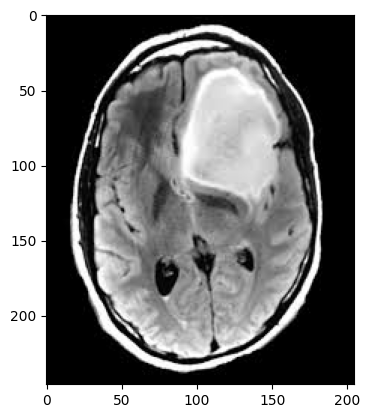

In [ ]:
img = cv2.imread(paths_si[1]) #El resultado es una matriz de matrices muy grande, asi que lo mejor es no mostrarlo jaja
plt.imshow(img)

Este pedazo lo hice para "contener" todas las imagenes en una sola variable.
Voy a crear un vector y cada una de los componentes es una imagen

Tiempo aproximado de ejecución, 20-40 segundos.

In [ ]:
ImagTrain_si=[]
ImagTrain_no=[]
ImagTest_si=[]
ImagTest_no=[]

for camino in Entrenamiento_si:
  ImagenMatriz=cv2.imread(camino)
  ImagenMatriz=cv2.cvtColor(ImagenMatriz,cv2.COLOR_BGR2GRAY)
  ImagTrain_si.append(ImagenMatriz)

for camino in Entrenamiento_no:
  ImagenMatriz=cv2.imread(camino)
  ImagenMatriz=cv2.cvtColor(ImagenMatriz,cv2.COLOR_BGR2GRAY)
  ImagTrain_no.append(ImagenMatriz)

for camino in prueba_si:
  ImagenMatriz=cv2.imread(camino)
  ImagenMatriz=cv2.cvtColor(ImagenMatriz,cv2.COLOR_BGR2GRAY)
  ImagTest_si.append(ImagenMatriz)

for camino in prueba_no:
  ImagenMatriz=cv2.imread(camino)
  ImagenMatriz=cv2.cvtColor(ImagenMatriz,cv2.COLOR_BGR2GRAY)
  ImagTest_no.append(ImagenMatriz)


imagenes_si=ImagTrain_si+ImagTest_si
imagenes_no=ImagTrain_no+ImagTest_no

In [ ]:
print("Tamaño de las primeras 3 imágenes con cancer: ", imagenes_si[0].shape, imagenes_si[1].shape,
imagenes_si[2].shape)

print("Tamaño de las primeras 3 imágenes sin cancer: ", imagenes_no[0].shape, imagenes_no[1].shape,
imagenes_no[2].shape)

Tamaño de las primeras 3 imágenes con cancer:  (1200, 1059) (246, 205) (336, 300)
Tamaño de las primeras 3 imágenes sin cancer:  (242, 208) (259, 194) (168, 300)


Como se puede observar las todas las imágenes tienen diferentes tamaños, por lo que posteriormente se va a tener que ajustar un mismo tamaño para todas de modo que se pueda realizar un análisis de comparación entre ellas

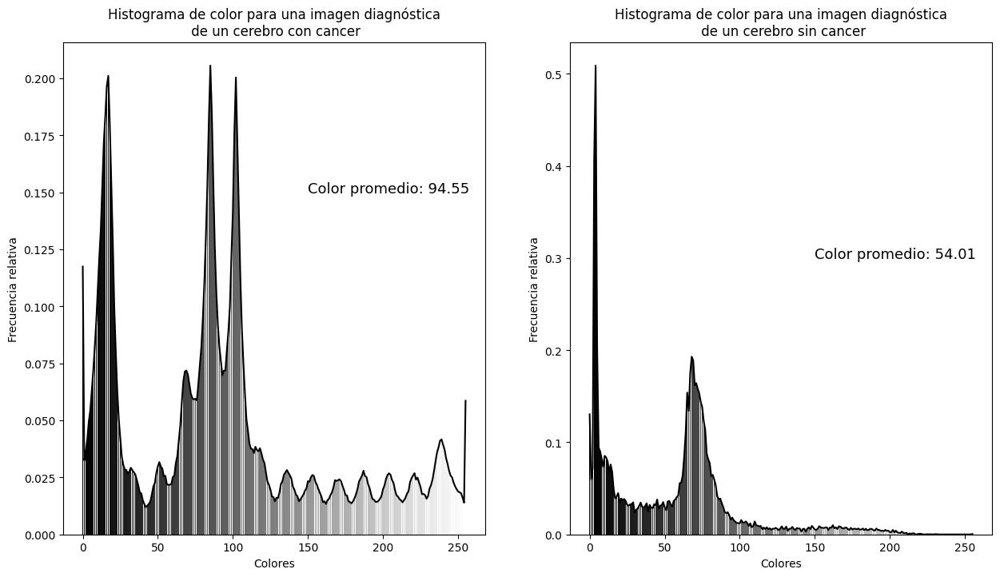

In [ ]:
plt.figure(figsize=(15,8))
plt.subplot(1,2,1)

histr1 = cv2.calcHist([imagenes_si[4]],[0],None,[256],[0,256]) # Calcula el histograma
histr1 = cv2.normalize(histr1, histr1) # Normaliza el histograma para hacerlo robusto ante imágenes de distintas dimensiones.
plt.plot(histr1, color="black")

# Crear un arreglo de colores para cada barra del histograma
colores = LinearSegmentedColormap.from_list('custom',
                                       [(0, '#000000'),
                                        (1, '#FFFFFF')], N=256)

# Crear el gráfico de barras
plt.bar(range(len(histr1)), histr1.flatten(), color=colores(range(len(histr1))))
plt.text(150, 0.15, 'Color promedio: '+str(round(np.average(imagenes_si[4]),2)), fontsize=13, color='black')
plt.xlabel("Colores")
plt.ylabel("Frecuencia relativa")
plt.title("Histograma de color para una imagen diagnóstica\n de un cerebro con cancer")

plt.subplot(1,2,2)

histr0 = cv2.calcHist([imagenes_no[9]],[0],None,[256],[0,256]) # Calcula el histograma
histr0 = cv2.normalize(histr0, histr0) # Normaliza el histograma para hacerlo robusto ante imágenes de distintas dimensiones.
plt.plot(histr0, color="black")

# Crear el gráfico de barras
plt.bar(range(len(histr0)), histr0.flatten(), color=colores(range(len(histr0))))
plt.text(150, 0.3, 'Color promedio: '+str(round(np.average(imagenes_no[9]),2)), fontsize=13, color='black')
plt.xlabel("Colores")
plt.ylabel("Frecuencia relativa")
plt.title("Histograma de color para una imagen diagnóstica\n de un cerebro sin cancer")
plt.show()

Podemos utilizar la función $\texttt{plt.imshow()}$ para mostrar las imagenes. recordemos que tenemos un vector donde cada componente es una imagen, entonces debemos aclarar el indice.

In [ ]:
hist_si=[]
hist_no=[]

for img in imagenes_si:
  hist=cv2.calcHist([img],[0],None,[256],[0,256])
  hist=cv2.normalize(hist, hist).flatten()
  hist_si.append(hist)

for img in imagenes_no:
  hist=cv2.calcHist([img],[0],None,[256],[0,256])
  hist=cv2.normalize(hist, hist).flatten()
  hist_no.append(hist)

hist_si=np.array(hist_si)
hist_no=np.array(hist_no)
prom_si=np.zeros(256)
prom_no=np.zeros(256)
Q1_si=np.zeros(256)
Q3_si=np.zeros(256)
Q1_no=np.zeros(256)
Q3_no=np.zeros(256)
Med_si=np.zeros(256)
Med_no=np.zeros(256)
for i in range(256):
  P_si=np.average(hist_si[:,i])
  q1_si=np.percentile(hist_si[:,i],25,interpolation = 'midpoint')
  q3_si=np.percentile(hist_si[:,i],75,interpolation = 'midpoint')
  M_si=np.median(hist_si[:,i])
  prom_si[i] = P_si
  Q1_si[i] = q1_si
  Q3_si[i] = q3_si
  Med_si[i] = M_si

for i in range(256):
  P_no=np.average(hist_no[:,i])
  q1_no=np.percentile(hist_no[:,i],25,interpolation = 'midpoint')
  q3_no=np.percentile(hist_no[:,i],75,interpolation = 'midpoint')
  M_no=np.median(hist_no[:,i])
  prom_no[i] = P_no
  Q1_no[i] = q1_no
  Q3_no[i] = q3_no
  Med_no[i] = M_no

<ipython-input-12-bb249da1cb93>:26: DeprecationWarning: the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  q1_si=np.percentile(hist_si[:,i],25,interpolation = 'midpoint')
<ipython-input-12-bb249da1cb93>:27: DeprecationWarning: the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22)
  q3_si=np.percentile(hist_si[:,i],75,interpolation = 'midpoint')
<ipython-input-12-bb249da1cb93>:36: DeprecationWarning: the `interpolation=` argument to percentile was renamed to `method=`, which has additional options.
Users of the modes 'nearest', 'lower', 'higher', or 'midpoint' are encouraged to review the method they used. (Deprecated NumPy 1.22

In [ ]:
len(hist_si)

155

Text(0.5, 1.0, 'Histograma promedio de color para imagenes diagnósticas\n de un cerebro sin cancer')

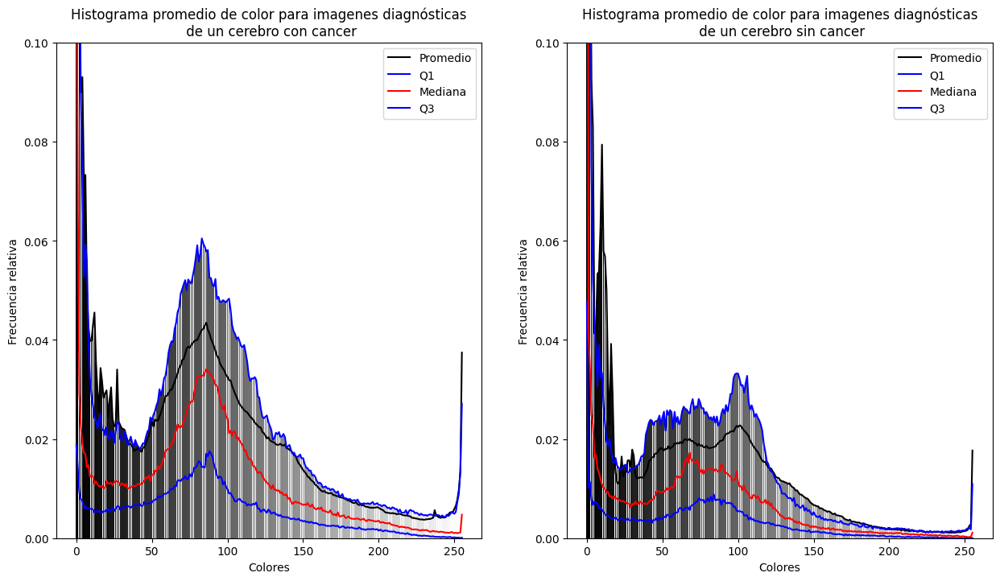

In [ ]:
plt.figure(figsize=(15,8))
plt.subplot(1,2,1)

plt.plot(range(len(prom_si)), prom_si, color="black", label="Promedio")
plt.plot(range(len(prom_si)), Q1_si, color="blue", label="Q1")
plt.plot(range(len(prom_si)), Med_si, color="red", label="Mediana")
plt.plot(range(len(prom_si)), Q3_si, color="blue", label="Q3")
plt.legend()
plt.bar(range(len(prom_si)), Q3_si, color=colores(range(len(prom_si))))
plt.bar(range(len(prom_si)), prom_si, color=colores(range(len(prom_si))))
plt.ylim((0,0.1))
plt.xlabel("Colores")
plt.ylabel("Frecuencia relativa")
plt.title("Histograma promedio de color para imagenes diagnósticas\n de un cerebro con cancer")

plt.subplot(1,2,2)

plt.plot(range(len(prom_no)), prom_no, color="black", label="Promedio")
plt.plot(range(len(prom_no)), Q1_no, color="blue", label="Q1")
plt.plot(range(len(prom_no)), Med_no, color="red", label="Mediana")
plt.plot(range(len(prom_no)), Q3_no, color="blue", label="Q3")
plt.legend()
plt.bar(range(len(prom_no)), prom_no, color=colores(range(len(prom_si))))
plt.bar(range(len(prom_no)), Q3_no, color=colores(range(len(prom_no))))
plt.ylim((0,0.1))
plt.xlabel("Colores")
plt.ylabel("Frecuencia relativa")
plt.title("Histograma promedio de color para imagenes diagnósticas\n de un cerebro sin cancer")

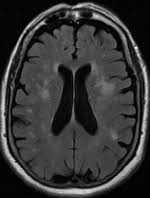

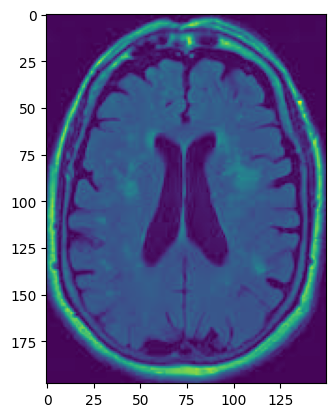

In [ ]:
img_no_9 = Image.open(Entrenamiento_no[9]).convert('L')
plt.imshow(imagenes_no[9])
img_no_9

<ipython-input-16-613749b8606f>:3: RuntimeWarning: divide by zero encountered in log
  plt.plot(np.log(img3.histogram()))


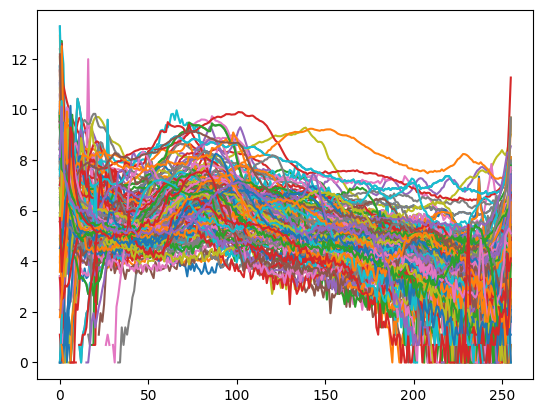

<ipython-input-16-613749b8606f>:8: RuntimeWarning: divide by zero encountered in log
  plt.plot(np.log(img4.histogram()))


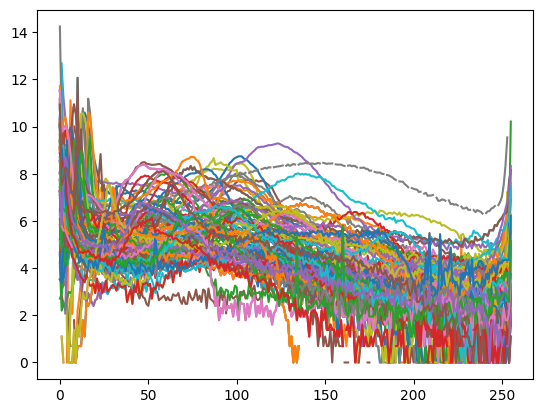

In [ ]:
for i in range(len(imagenes_si)):
  img3 = Image.open(paths_si[i]).convert('L')
  plt.plot(np.log(img3.histogram()))
plt.show()

for i in range(len(imagenes_no)):
  img4 = Image.open(paths_no[i]).convert('L')
  plt.plot(np.log(img4.histogram()))
plt.show()

#Imagenes artificiales- Data Augmentation


Data augmentation artificially increases the size of the training set by generating
many realistic variants of each training instance. This reduces overfitting, making this
a regularization technique. The generated instances should be as realistic as possible:
ideally, given an image from the augmented training set, a human should not be able
to tell whether it was augmented or not. Simply adding white noise will not help; the
modifications should be learnable (white noise is not).

In [ ]:
def noisy(noise_typ,image):
  if noise_typ == "gauss":
    row,col= image.shape
    mean = 0
    var = 100
    sigma = var**(1/2)
    gauss = np.random.normal(mean,sigma,(row,col))
    gauss = gauss.reshape(row,col)
    noisy = image + gauss
    return noisy
  elif noise_typ == "s&p":
    row,col = image.shape
    s_vs_p = 0.5
    amount = 0.004
    out = np.copy(image)
    # Salt mode
    num_salt = np.ceil(amount * image.size * s_vs_p)*3
    coords = [np.random.randint(0, i - 1, int(num_salt))
            for i in image.shape]
    out[coords] = 1

    # Pepper mode
    num_pepper = np.ceil(amount* image.size * (1. - s_vs_p))*3
    coords = [np.random.randint(0, i - 1, int(num_pepper))
            for i in image.shape]
    out[coords] = 0
    return out
  elif noise_typ == "poisson":
    vals = len(np.unique(image))*10
    vals = 2 ** np.ceil(np.log2(vals))
    noisy = np.random.poisson(image * vals) / float(vals)
    return noisy
  elif noise_typ =="speckle":
    row,col = image.shape
    gauss = np.random.randn(row,col)
    gauss = gauss.reshape(row,col)
    noisy = image + image * gauss
    return noisy



def recortar(imagen,tamano=None, x_inicial=None,y_inicial=None):
  if x_inicial==None:
    x_inicial=int(imagen.shape[0]/8)
  if y_inicial==None:
    y_inicial=int(imagen.shape[1]/8)
  if tamano==None:
    tamano=[int(7*imagen.shape[0]/8+1),int(7*imagen.shape[1]/8+1)]
    recorte= imagen[x_inicial:tamano[0],y_inicial:tamano[1]]
  else:
    recorte= imagen[x_inicial:x_inicial+tamano[0],y_inicial:y_inicial+tamano[1]]
  return recorte

In [ ]:
def gaussn(img):
  return noisy("gauss",img)

def saltpepper(img):
  return noisy("s&p",img)
def poissonn(img):
  return noisy("poisson",img)
def specklen(img):
  return noisy("speckle",img)

def gaussblur(img):
  return cv2.GaussianBlur(img,(3,3),0.5)

def medianblur(img):
  return cv2.medianBlur(img,(5))

def blur(img):
  return cv2.blur(img,(2,2))

def biblur(img):
  return cv2.bilateralFilter(img,9,30,30)

def reflexionx(img):
  return cv2.flip(img,1)
def reflexiony(img):
  return cv2.flip(img,0)
def reflexionxy(img):
  return cv2.flip(img,-1)

def rotation90(img):
  return cv2.rotate(img, cv2.ROTATE_90_CLOCKWISE)
def rotation270(img):
  return cv2.rotate(img, cv2.ROTATE_90_COUNTERCLOCKWISE)

def rotation180(img):
  return cv2.rotate(img, cv2.ROTATE_180)

In [ ]:
artificial_no=[]
for imag in ImagTrain_no:
  transformaciones = [
           "blur",
           "gaussn",
           "saltpepper",
           "poissonn",
           "specklen",
           "gaussblur",
           "medianblur",
           "biblur"]
  i=0
  recnum=random.randint(0,1)
  rotnum=random.randint(0,3)
  refnum=random.randint(0,3)
  if recnum==1:
    imag=recortar(imag)
  if rotnum==3:
    imag=rotation270(imag)
  elif rotnum==2:
    imag=rotation180(imag)
  elif rotnum==1:
    imag=rotation90(imag)

  if refnum==3:
    imag=reflexionxy(imag)
  elif refnum==2:
    imag=reflexiony(imag)
  elif refnum==1:
    imag=reflexionx(imag)

  l=len(transformaciones)
  while i<=3:
    index=random.randint(0,len(transformaciones)-1) #Toma una transformacion cualquiera
    funcion=transformaciones.pop(index)
    img=eval(funcion+"(imag)") #La aplica
    i+=1
  artificial_no.append(img)


Artificialno=ImagTrain_no+artificial_no

IndexError: ignored

In [ ]:
SalvoNo=ImagTrain_no
ImagTrain_no=Artificialno
#ImagTrain_no=SalvoNo

NameError: ignored

#La red neuronal basica

##Preprocesamiento de las imagenes
A continuación, vamos a construir una red neuronal genérica, a la cual llamaremos, $\texttt{naive}$. En esta sección, explicaré a detalle cada una de las funciones para evitar tener que dar tantas explicaciones más adelante.

Lo primero que haremos, es asignarle las respectivas etiquetas de diagnostico (tumor o normal) a las imagenes del conjunto de entrenamiento.

In [ ]:
#treinamento_sim ,prova_sim = train_test_split(imagenes_si,test_size=0.2)
#prova_sim,evaluacao_sim=train_test_split(prova_sim,test_size=0.3)
#treinamento_nao ,prova_nao = train_test_split(imagenes_no,test_size=0.2)
#prova_nao,evaluacao_nao=train_test_split(prova_nao,test_size=0.3)
ImagTrain=ImagTrain_si+ImagTrain_no[:len(ImagTrain_si)] #Definimos nuestro conjunto de entrenamiento
ImagEval_si=ImagTest_si  #Nuestro conjunto de evaluación será el mismo cnojunto de prueba
ImagEval_no=ImagTest_no
etiquetas_Positivo=[] #Com tumor
etiquetas_Negativo=[] #Sem tumor

#Asignamos las etiquetas
for img in ImagTrain_no:
  etiquetas_Negativo.append("NORMAL")
for img in ImagTrain_si:
  etiquetas_Positivo.append("TUMOR")

etiquetas=etiquetas_Positivo+etiquetas_Negativo[:len(ImagTrain_si)]

#Agrupamos todo en un dataframe por facilidad en la manipulacion de os datos
dados=pd.DataFrame(ImagTrain)
dados.columns=["Imagens"]
dados["Diagnostico"]=etiquetas
dados=dados.sample(frac=1).reset_index(drop=True)

dados

/usr/local/lib/python3.10/dist-packages/pandas/core/internals/construction.py:568: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  values = np.array([convert(v) for v in values])


,Imagens,Diagnostico
0,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",NORMAL
1,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",TUMOR
2,"[[29, 32, 32, 40, 28, 31, 21, 34, 28, 28, 28, ...",TUMOR
3,"[[254, 255, 255, 253, 255, 255, 255, 255, 255,...",TUMOR
4,"[[12, 11, 11, 10, 10, 10, 11, 12, 12, 13, 13, ...",TUMOR
...,...,...
202,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",TUMOR
203,"[[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,...",NORMAL
204,"[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,...",NORMAL
205,"[[2, 2, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1,...",NORMAL


In [ ]:
len(ImagTrain_si)

109

In [ ]:
Train=[]
j=0

for img in dados.Imagens:
  j=j+1
  image = cv2.convertScaleAbs(img)
  print("Tipo de dato de la imagen:", image.dtype)
  Train.append(image)
  #cv2.imwrite("drive/MyDrive/Modelos predictivos para enfermedades /Base de datos Cerebro- Kaggle/Entrenamiento/no_artificial/"+str(j)+".jpg", image)

Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de da

Podemos hacer un diagrama de barras para ver la propoorción de cada clase en el conjunto de entrenamiento.

Los datos están desbalanceados, esto puede representar un problema en el desempeño de las redes neuronales construidas, sin embargo. vamos a continuar de esta forma.

<BarContainer object of 2 artists>

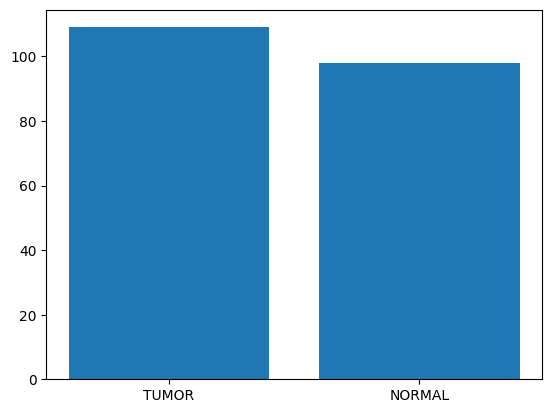

In [ ]:
plt.bar(dados["Diagnostico"].value_counts().index,dados["Diagnostico"].value_counts().values)

#DATOS DESBALANCEADOOS

/usr/local/lib/python3.10/dist-packages/pandas/core/internals/construction.py:568: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  values = np.array([convert(v) for v in values])


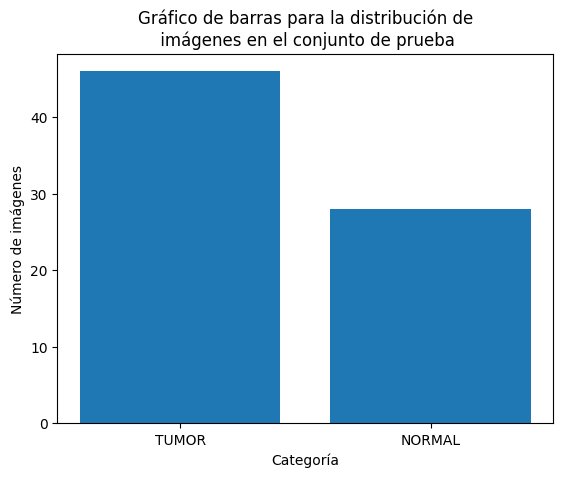

In [ ]:
etiquetas_Positivo_Prueba=[] #Com tumor
etiquetas_Negativo_Prueba=[] #Sem tumor

#Asignamos las etiquetas
for img in ImagTest_no:
  etiquetas_Negativo_Prueba.append("NORMAL")
for img in ImagTest_si:
  etiquetas_Positivo_Prueba.append("TUMOR")

etiquetas_prueba=etiquetas_Positivo_Prueba+etiquetas_Negativo_Prueba
ImagTest=ImagTest_no+ImagTest_si
#Agrupamos todo en un dataframe por facilidad en la manipulacion de os datos
dadosTest=pd.DataFrame(ImagTest)
dadosTest.columns=["Imagens"]
dadosTest["Diagnostico"]=etiquetas_prueba
dadosTest=dadosTest.sample(frac=1).reset_index(drop=True)


plt.bar(dadosTest["Diagnostico"].value_counts().index,dadosTest["Diagnostico"].value_counts().values)
plt.xlabel("Categoría")
plt.ylabel("Número de imágenes")
plt.title("Gráfico de barras para la distribución de\n imágenes en el conjunto de prueba")

plt.show()

In [ ]:
len(ImagTest_si)

46

La función a continuación es netamente ilustrativa, no tiene aporte alguno a la construcción del modelo. Mas sirve para verificar que las etiquetas fueron asignadas correctamente

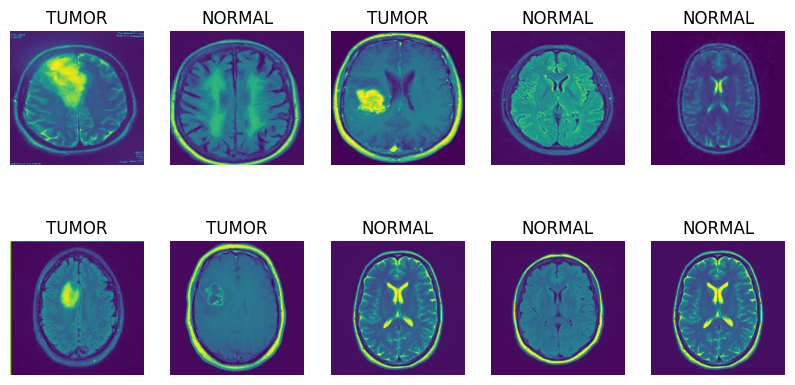

In [ ]:
def plot(imagens,etiqueta):
  plt.figure(figsize=(10,5))
  for i in range(10):
    ax=plt.subplot(2,5,i+1)
    imagem=cv2.resize(imagens[i],(224,224))
    plt.imshow(imagem)
    plt.title(etiqueta[i])
    plt.axis("off")

bla=dados.sample(n=10).reset_index(drop=True)
bla.Imagens, bla.Diagnostico
plot(bla.Imagens,bla.Diagnostico)

Vamos a comenzar con el preprocesamiento de las imagenes. para esto, definimos la función preprocessmamento con parámetro ($\texttt{isval}$). El cual especifica si vamos a preprocesar el conjunto de pruebas o de validación. Aquí mismo, aclaramos que el conjunto de prueba y validación son el mismo.

El preprocesamiento del conjunto de entrenamiento se realizará más adelante.

In [ ]:
def preprocessamento(isval=True):
  if isval==True: #Si es verdadero, tomaremos el conjunto de validacion
    positivo=ImagEval_si
    negativo=ImagEval_no
  else: #Caso contrario, tomaremos el conjunto de test
    positivo= ImagTest_si
    negativo= ImagTest_no
  dados,diagnostico=([] for x in range(2))
  def preparar(caso):
    for img in caso: #Para cada imagen en el conjunto de datos
      img=cv2.resize(img,(224,224)) #Ajustamos el tamaño de la imagen
      if len(img.shape)>2: #En caso de que la imagen tenga una dimensión diferente, afortunamente, esto no ocurre en nuestro conjunto de datps, pero por si acaso
        if img.shape[2]==1:
          img=np.dstack([img,img,img])
      img=cv2.cvtColor(img,cv2.COLOR_BGR2RGB) #Convertimos nuestras imagenes al formato RGB
      img=img.astype(np.float32)/255 #normalizamos la imagen
      if caso==negativo: #Asignamos la etiqueta, el valor 0 representa que no hay tumor.
        label=kr.utils.to_categorical(0,num_classes=2) #El parametro num_classes es el numero de clases posibles, en nuestro caso solo hay dos, tumor y normal
      else: #El valor 1 representa que tiene tumor
        label=kr.utils.to_categorical(1,num_classes=2)
      dados.append(img)
      diagnostico.append(label)
    return dados, diagnostico
  preparar(negativo)
  d,l=preparar(positivo)
  d=np.array(d)
  l=np.array(l)
  return d,l

In [ ]:
val_data,val_labels=preprocessamento(isval=True) #Tomamos el conjunto de validación y sus etiquetas
dadosProva,DiagnosticoProva=preprocessamento(isval=False) #tomamos el conjunto de prueba y sus etiquetas
print("Número de casos de prueba: ", len(dadosProva)) #Podemos verificar que los datos fueron tomados adecuadamente mediante la cantidad
print("Número de casos de evaluación: ",len(val_data))

Número de casos de prueba:  74
Número de casos de evaluación:  74


Ahora, vamos a construir una función para generar lotes de imagenes a partir de nuestro conjunto de entrenamiento.

La generación de lotes y el preprocesamiento de los datos es una parte importante del flujo de trabajo de entrenamiento de una red neuronal. Sin embargo, no es algo que se haga directamente en la construcción de la red neuronal en sí. En cambio, suele realizarse como un paso separado antes de comenzar el entrenamiento del modelo. Esto es común cuando se tienen conjuntos de datos grandes y no se pueden cargar todos los datos en la memoria al mismo tiempo. El generador se utiliza para iterar a través del conjunto de datos en lotes más pequeños, proporcionando un flujo continuo de datos para el entrenamiento del modelo.

Entonces, en resumen, si bien la generación de lotes de datos y el preprocesamiento son tareas importantes en el entrenamiento de una red neuronal, no forman parte directa de la construcción de la red neuronal en sí.

Lo de arriba es una pequeña explicacion de chatGPT

In [ ]:
def generador(dados,tamanho):
  n=len(dados)
  pasos=n//tamanho #Función piso para determinar el numero de pasos a utilizar

  batch_dados=np.zeros((tamanho, 224,224,3),dtype=np.float32)
  batch_diagnostico=np.zeros((tamanho,2),dtype=np.float32)
  indices=np.arange(n)

  i=0
  while True:
    np.random.shuffle(indices)

    #Obtenemos el siguiente batch (grupo de imagenes)
    conta= 0
    seguinte_batch=indices[(i*tamanho):(i+1)*tamanho] #Tomamos un subconjunto de tamaño "tamanho"
    for j, idx in enumerate(seguinte_batch): #Tomamos las imagenes y los diagnosticos de cada subconjunto
      nome_imagem=(dados.iloc[idx]["Imagens"])
      etiqueta=dados.iloc[idx]["Diagnostico"]
      if etiqueta=="NORMAL": #Asignamos el valor numerico de la etiqueta
        etiqueta=0
      else:
        etiqueta=1

      etiqueta_codificada=kr.utils.to_categorical(etiqueta,num_classes=2)

      #Ajustamos el tamaño de la imagen
      img=cv2.resize(nome_imagem,(224,224))
      img=cv2.convertScaleAbs(img)


      #Verifica si la imagen tenga el tamaño adecuado
      if len(img.shape)>2:
        if img.shape[2]==1:
          img=np.dstack([img,img,img])

  #Convertimos las imagenes a formato RGB
      img_original=cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
  #Normalizamos las imagenes
      img_original=img_original.astype(np.float32)/255
 #Asignamos la imagen normalizada al batch
      batch_dados[conta]=img_original
      batch_diagnostico[conta]=etiqueta_codificada
      conta+=1

      if conta==tamanho-1:
        break
    i+=1
    yield batch_dados,batch_diagnostico

    if i>=pasos:
      i=0

#En resumen, esta función genera lotes de imágenes y etiquetas codificadas para entrenar un modelo.
#Los datos se procesan y ajustan para cumplir con los requisitos del modelo antes de ser devueltos como salida del generador.



##Construcción del modelo

Una vez preprocesadas las imagenes, vamos a empezar la construcción del modelo.

Construimos un modelo secuencial y vamos añadiendole capas, especificando el numero de filtros y la función de activación


La siguiente construcción del modelo, fue una genérica que saqué de internet xd.

In [ ]:
model=kr.models.Sequential()
model.add(kr.layers.Conv2D(32,(3,3),input_shape=(224,224,3)))
#Função de activação relu
model.add(kr.layers.Activation("relu"))
#Função pooling
model.add(kr.layers.MaxPooling2D(pool_size=(2,2)))


model.add(kr.layers.Conv2D(32,(3,3)))
model.add(kr.layers.Activation("relu"))
model.add(kr.layers.MaxPooling2D(pool_size=(2,2)))

model.add(kr.layers.Conv2D(64,(3,3)))
model.add(kr.layers.Activation("relu"))
model.add(kr.layers.MaxPooling2D(pool_size=(2,2)))

model.add(kr.layers.Flatten()) #Isto converte os mapeos #D em vetores de caracteriscas 1D

model.add(kr.layers.Dense(64))
model.add(kr.layers.Activation("relu"))
model.add(kr.layers.Dense(2))
model.add(kr.layers.Activation("softmax"))

Podemos tener una visualización grafica de la red neuronal por medio del siguiente comando.

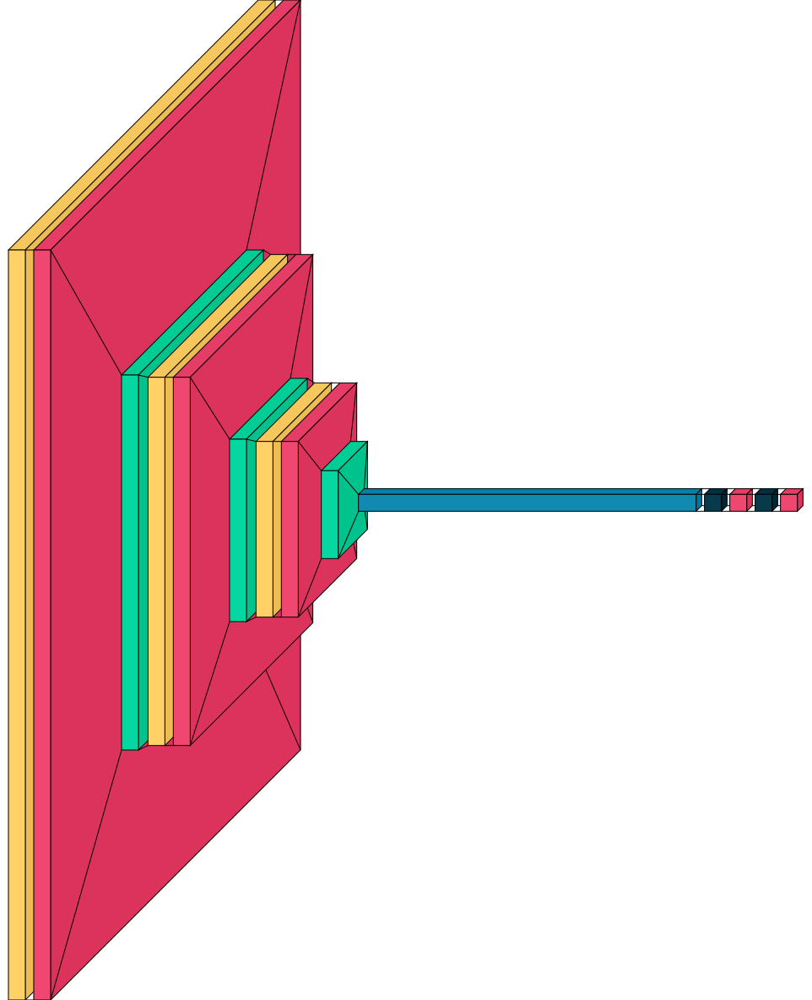

In [ ]:
visualkeras.layered_view(model)

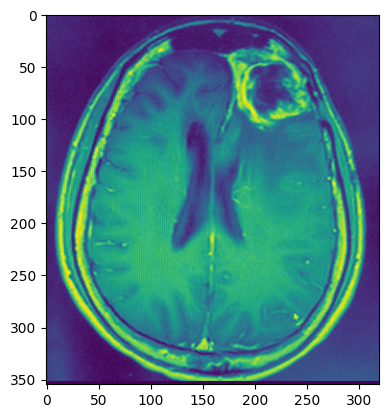

In [ ]:
plt.imshow(dados["Imagens"][150])

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 activation (Activation)     (None, 222, 222, 32)      0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 111, 111, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 32)      9248      
                                                                 
 activation_1 (Activation)   (None, 109, 109, 32)      0         
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 54, 54, 32)       0         
 2D)                                                    

Ahora, definimos el tamaño de cada batch y el numero de epocas a considerar en el modelo.

Luego, generamos los datos y los pasos a utilizar en cada epoca durante el entrenamiento

In [ ]:
tamanho=20
nb_epochs=30
dados_train_gerados=generador(dados=dados,tamanho=tamanho)


nb_train_pasos=dados.shape[0]//tamanho

print("Los número de pasos de entrenamiento y validación son: {} y {}".format(nb_train_pasos,len(val_data)))

Los número de pasos de entrenamiento y validación son: 10 y 74


Para obtener una mejor visualización de los resultados durante el entramiento del modelo, vamos a utilizar tensorboard. Para eso, utilizamos el siguiente codigo para definir el directorio donde se guardará la información.

In [ ]:

def get_run_logdir(root_logdir):
    run_id = time.strftime("run_%Y_%m_%d-%H_%M_%S")
    return os.path.join(root_logdir, run_id)
root_logdir = os.path.join(os.curdir, "logs/fit/")
run_logdir = get_run_logdir(root_logdir)
tensorboard_cb = kr.callbacks.TensorBoard(run_logdir)

Ahora, compilamos el modelo, definiendo el método de la optimización, las métricas a considerar y la función de pérdida.

Posteriormente, utilizamos model.fit para entrenar el modelo.

Pdta: una época en el entrenamiento de una red neuronal se refiere a un ciclo completo a través de todos los datos de entrenamiento, donde se realizan actualizaciones de los pesos del modelo para mejorar su rendimiento. El número de épocas es un hiperparámetro que determina cuántas veces se recorrerá todo el conjunto de datos de entrenamiento durante el entrenamiento. El "número de pasos por época" se refiere al número de actualizaciones de los pesos del modelo que se realizan durante una época completa de entrenamiento.

In [ ]:
model.compile(loss="binary_crossentropy",
              optimizer="rmsprop",
              metrics=["accuracy"])



In [ ]:
#Ajustamos o modelo
history=model.fit(dados_train_gerados,
                  epochs=25,
                  steps_per_epoch=nb_train_pasos,
                  validation_data=(val_data,val_labels),
                  validation_freq=1,
                  callbacks=[tensorboard_cb]
                  )

Epoch 1/25
10/10 [==============================] - 37s 3s/step - loss: 0.7244 - accuracy: 0.5900 - val_loss: 0.5713 - val_accuracy: 0.7568
Epoch 2/25
10/10 [==============================] - 17s 2s/step - loss: 0.6319 - accuracy: 0.6650 - val_loss: 0.5262 - val_accuracy: 0.7838
Epoch 3/25
10/10 [==============================] - 16s 2s/step - loss: 0.5104 - accuracy: 0.7750 - val_loss: 0.4541 - val_accuracy: 0.7432
Epoch 4/25
10/10 [==============================] - 17s 2s/step - loss: 0.4470 - accuracy: 0.7950 - val_loss: 0.5021 - val_accuracy: 0.7162
Epoch 5/25
10/10 [==============================] - 16s 2s/step - loss: 0.4183 - accuracy: 0.8250 - val_loss: 0.5967 - val_accuracy: 0.7568
Epoch 6/25
10/10 [==============================] - 18s 2s/step - loss: 0.3778 - accuracy: 0.7950 - val_loss: 0.3769 - val_accuracy: 0.8108
Epoch 7/25
10/10 [==============================] - 20s 2s/step - loss: 0.2584 - accuracy: 0.8500 - val_loss: 0.6041 - val_accuracy: 0.7162
Epoch 8/25
10/10 [==

Una vez entrenado el modelo, utilizamos los pesos calculados para predecir y comparar con los datos de prueba.


In [ ]:
predicoes=model.predict(dadosProva,batch_size=tamanho)
predicoes=np.argmax(predicoes,axis=-1)


#Diagnosticos originais
etiquetas=np.argmax(DiagnosticoProva,axis=-1)

from sklearn.metrics import classification_report,confusion_matrix
print(classification_report(etiquetas,predicoes))

4/4 [==============================] - 1s 303ms/step
              precision    recall  f1-score   support

           0       0.74      1.00      0.85        28
           1       1.00      0.78      0.88        46

    accuracy                           0.86        74
   macro avg       0.87      0.89      0.86        74
weighted avg       0.90      0.86      0.87        74



Para una mejor visualización, construimos la matriz de confusión.

<Axes: >

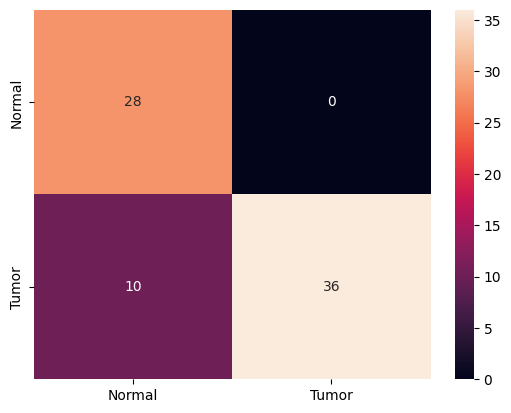

In [ ]:
cm=confusion_matrix(etiquetas,predicoes)
sns.heatmap(cm,annot=True,fmt="g",xticklabels=['Normal','Tumor'],yticklabels=['Normal','Tumor'])

Para ver el comportamiento de la función de perdida en cada epoca, utilizamos el tensorboard previamente definido.

Aun no sé interpretar estos graficos muy bien.

In [ ]:
%tensorboard --logdir logs/fit

Reusing TensorBoard on port 6006 (pid 21488), started 1:05:05 ago. (Use '!kill 21488' to kill it.)

<IPython.core.display.Javascript object>

El siguiente codigo es para terminar el tensorboard, ya que solo se puede realizar uno a la vez.

In [ ]:
!kill 21488

#Usando distitas arquitecturas de CNN

Del libro guia:

  Las arquitecturas típicas de las redes neuronales convolucionales (CNN) apilan varias capas convolucionales (cada una generalmente seguida de una capa ReLU), luego una capa de agrupación, luego algunas capas convolucionales más (+ReLU), luego otra capa de agrupación, y así sucesivamente. A medida que la imagen avanza a través de la red, se vuelve más pequeña, pero también típicamente se vuelve más profunda (es decir, con más mapas de características), gracias a las capas convolucionales. En la parte superior de la pila, se agrega una red neuronal feedforward regular, compuesta por algunas capas totalmente conectadas (+ReLUs), y la capa final produce la predicción (por ejemplo, una capa softmax que produce probabilidades estimadas de clase).

  A lo largo de los años, se han desarrollado variantes de esta arquitectura fundamental, lo que ha llevado a avances sorprendentes en el campo. Una buena medida de este progreso es la tasa de error en competencias como el desafío de ImageNet ILSVRC. En esta competencia, la tasa de error de los cinco primeros para la clasificación de imágenes ha disminuido de más del 26% a menos del 2.3% en solo seis años. La tasa de error de los cinco primeros es el número de imágenes de prueba para las cuales las cinco principales predicciones del sistema no incluyeron la respuesta correcta. Las imágenes son grandes (256 píxeles de altura) y hay 1,000 clases, algunas de las cuales son realmente sutiles (intenta distinguir entre 120 razas de perros). Observar la evolución de las entradas ganadoras es una buena manera de entender cómo funcionan las CNN.

  Primero veremos la arquitectura clásica de LeNet-5 (1998), luego tres de los ganadores del desafío ILSVRC: AlexNet (2012), GoogLeNet (2014) y ResNet (2015).

¿Vale la pena balancear los datos?

Por si acaso, aqui están

In [ ]:
#Vamos a balancear los datos
ImagTrain_si2=ImagTrain_si[:len(ImagTrain_no)]

ImagTrain2=ImagTrain_si2+ImagTrain_no #Definimos nuestro conjunto de entrenamiento
ImagEval_si=ImagTest_si  #Nuestro conjunto de evaluación será el mismo cnojunto de prueba
ImagEval_no=ImagTest_no
etiquetas_Positivo2=[] #Com tumor
etiquetas_Negativo=[] #Sem tumor
for img in ImagTrain_no:
  etiquetas_Negativo.append("NORMAL")
for img in ImagTrain_si2:
  etiquetas_Positivo2.append("TUMOR")

etiquetas2=etiquetas_Positivo2+etiquetas_Negativo
dados2=pd.DataFrame(ImagTrain2)
dados2.columns=["Imagens"]
dados2["Diagnostico"]=etiquetas2
dados2=dados2.sample(frac=1).reset_index(drop=True)


/usr/local/lib/python3.10/dist-packages/pandas/core/internals/construction.py:568: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  values = np.array([convert(v) for v in values])


<BarContainer object of 2 artists>

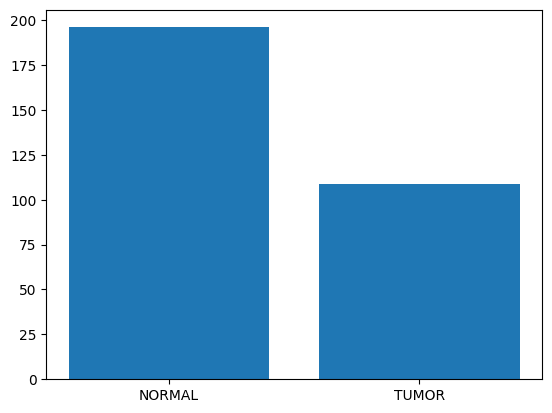

In [ ]:
plt.bar(dados2["Diagnostico"].value_counts().index,dados2["Diagnostico"].value_counts().values)


##***LeNet-5***

La estructura del modelo LeNet-5 es la siguiente:

In [ ]:
model_Lenet = kr.Sequential([
    kr.layers.Conv2D(filters=6, kernel_size=(5, 5), activation='tanh', input_shape=(224,224,3)),
    kr.layers.AveragePooling2D(),
    kr.layers.Conv2D(filters=16, kernel_size=(5, 5), activation='tanh'),
    kr.layers.AveragePooling2D(),
    kr.layers.Flatten(),
    kr.layers.Dense(units=120, activation='tanh'),
    kr.layers.Dense(units=84, activation='tanh'),
    kr.layers.Dense(units=2, activation = 'softmax')
])

Visualmente, esto se ve así.

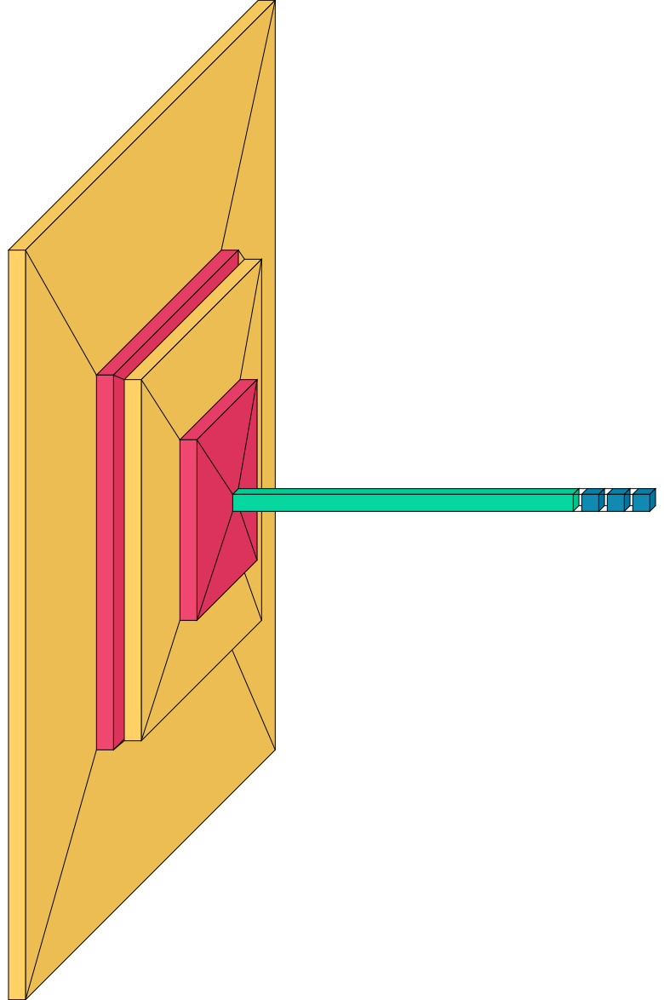

In [ ]:
visualkeras.layered_view(model_Lenet)

Tambien se puede ver el modelo como una tabla mediante la función summary

In [ ]:
model_Lenet.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_3 (Conv2D)           (None, 220, 220, 6)       456       
                                                                 
 average_pooling2d (AverageP  (None, 110, 110, 6)      0         
 ooling2D)                                                       
                                                                 
 conv2d_4 (Conv2D)           (None, 106, 106, 16)      2416      
                                                                 
 average_pooling2d_1 (Averag  (None, 53, 53, 16)       0         
 ePooling2D)                                                     
                                                                 
 flatten_1 (Flatten)         (None, 44944)             0         
                                                                 
 dense_2 (Dense)             (None, 120)              

In [ ]:
tamanho=20

dados_train_gerados2=generador(dados=dados,tamanho=tamanho)
Lenet_train_steps=dados.shape[0]//tamanho

model_Lenet.compile(loss='binary_crossentropy',
                   #optimizer="rmsprop",
                   optimizer=tf.optimizers.SGD(learning_rate=0.001),
                   metrics=['accuracy'])

In [ ]:
root_logdirLenet = os.path.join(os.curdir, "logs/fitLenet/")
run_logdir = get_run_logdir(root_logdirLenet)
tensorboard_Lenet= kr.callbacks.TensorBoard(run_logdir)

In [ ]:
history_Lenet=model_Lenet.fit(dados_train_gerados,
          epochs=50,
          validation_data=(val_data,val_labels),
          validation_freq=1,
          steps_per_epoch=Lenet_train_steps,
          callbacks=[tensorboard_Lenet])

Epoch 1/50
10/10 [==============================] - 12s 1s/step - loss: 0.6925 - accuracy: 0.5450 - val_loss: 0.6658 - val_accuracy: 0.6486
Epoch 2/50
10/10 [==============================] - 11s 1s/step - loss: 0.6856 - accuracy: 0.5750 - val_loss: 0.6551 - val_accuracy: 0.6351
Epoch 3/50
10/10 [==============================] - 11s 1s/step - loss: 0.6843 - accuracy: 0.5650 - val_loss: 0.6526 - val_accuracy: 0.6486
Epoch 4/50
10/10 [==============================] - 9s 908ms/step - loss: 0.6699 - accuracy: 0.5850 - val_loss: 0.6486 - val_accuracy: 0.6757
Epoch 5/50
10/10 [==============================] - 11s 1s/step - loss: 0.6723 - accuracy: 0.6350 - val_loss: 0.6515 - val_accuracy: 0.7297
Epoch 6/50
10/10 [==============================] - 11s 1s/step - loss: 0.6557 - accuracy: 0.7700 - val_loss: 0.6352 - val_accuracy: 0.7297
Epoch 7/50
10/10 [==============================] - 11s 1s/step - loss: 0.6474 - accuracy: 0.7200 - val_loss: 0.6319 - val_accuracy: 0.7432
Epoch 8/50
10/10 [

In [ ]:
predicoes_Lenet=model_Lenet.predict(dadosProva,batch_size=tamanho)
predicoes_Lenet=np.argmax(predicoes_Lenet,axis=-1)


#Diagnosticos originais
etiquetas=np.argmax(DiagnosticoProva,axis=-1)

print(classification_report(etiquetas,predicoes_Lenet))

4/4 [==============================] - 2s 455ms/step
              precision    recall  f1-score   support

           0       0.65      0.71      0.68        28
           1       0.81      0.76      0.79        46

    accuracy                           0.74        74
   macro avg       0.73      0.74      0.73        74
weighted avg       0.75      0.74      0.75        74



<Axes: >

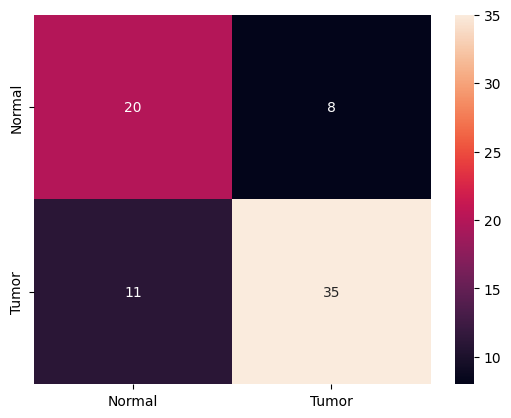

In [ ]:
cm=confusion_matrix(etiquetas,predicoes_Lenet)
sns.heatmap(cm,annot=True,fmt="g",xticklabels=['Normal','Tumor'],yticklabels=['Normal','Tumor'])

In [ ]:
%tensorboard --logdir logs/fitLenet

ERROR: Failed to launch TensorBoard (exited with 1).
Contents of stderr:
2023-07-30 17:09:27.430754: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT

NOTE: Using experimental fast data loading logic. To disable, pass
    "--load_fast=false" and report issues on GitHub. More details:
    https://github.com/tensorflow/tensorboard/issues/4784

Address already in use
Port 6006 is in use by another program. Either identify and stop that program, or start the server with a different port.

In [ ]:
!kill 5890

/bin/bash: line 1: kill: (5890) - No such process


In [ ]:
score=model_Lenet.evaluate(dadosProva,DiagnosticoProva)
score[1]*100

3/3 [==============================] - 1s 284ms/step - loss: 0.5075 - accuracy: 0.7432


74.32432174682617

##***AlexNet***

In [ ]:
model_Alex = kr.models.Sequential([
    kr.layers.Conv2D(filters=32, kernel_size=(11,11),strides=(4,4), activation='relu', input_shape=(224,224,3)), #Numero original de filtros 96
    kr.layers.BatchNormalization(),
    kr.layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    kr.layers.Conv2D(filters=64, kernel_size=(5,5), strides=(1,1), activation='relu', padding="same"), #Numero original de filtros 256
    kr.layers.BatchNormalization(),
    kr.layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    kr.layers.Conv2D(filters=128, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"), #Numero original de filtros 384
    kr.layers.BatchNormalization(),
    kr.layers.Conv2D(filters=256, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"), #384
    kr.layers.BatchNormalization(),
    kr.layers.Conv2D(filters=512, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same"), #256
    kr.layers.BatchNormalization(),
    kr.layers.MaxPool2D(pool_size=(3,3), strides=(2,2)),
    kr.layers.Flatten(),
    kr.layers.Dense(4096, activation='relu'),
    kr.layers.Dropout(0.5),
    kr.layers.Dense(4096, activation='relu'),
    kr.layers.Dropout(0.5),
    kr.layers.Dense(2, activation='softmax') #Numero de salidas
 ])

model_Alex2=model_Alex

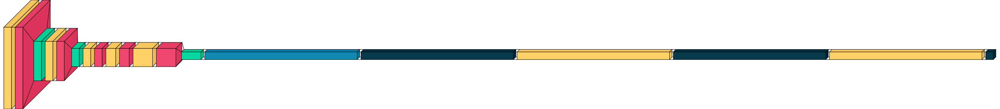

In [ ]:

visualkeras.layered_view(model_Alex)

In [ ]:
tamanho=20

dados_train_gerados2=generador(dados=dados2,tamanho=tamanho)
Alex_train_steps=dados.shape[0]//tamanho

model_Alex.compile(loss='binary_crossentropy',
                   #optimizer="rmsprop",
                   optimizer=tf.optimizers.SGD(learning_rate=0.001),
                   metrics=['accuracy'])

#Esto es solo para tomar el modelo definitivo despues de la validación
model_Alex2.compile(loss='binary_crossentropy',
                   #optimizer="rmsprop",
                   optimizer=tf.optimizers.SGD(learning_rate=0.001),
                   metrics=['accuracy'])
model_Alex.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 54, 54, 32)        11648     
                                                                 
 batch_normalization (BatchN  (None, 54, 54, 32)       128       
 ormalization)                                                   
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 26, 26, 32)       0         
 2D)                                                             
                                                                 
 conv2d_6 (Conv2D)           (None, 26, 26, 64)        51264     
                                                                 
 batch_normalization_1 (Batc  (None, 26, 26, 64)       256       
 hNormalization)                                                 
                                                      

In [ ]:
root_logdirAlex = os.path.join(os.curdir, "logs/fitAlex/")
run_logdir = get_run_logdir(root_logdirAlex)
tensorboard_Alex= kr.callbacks.TensorBoard(run_logdir)

In [ ]:
history_Alex=model_Alex.fit(dados_train_gerados,
          epochs=60,
          validation_data=(val_data,val_labels),
          validation_freq=1,
          steps_per_epoch=Alex_train_steps,
          callbacks=[tensorboard_Alex])

Epoch 1/60
10/10 [==============================] - 21s 2s/step - loss: 1.1504 - accuracy: 0.5750 - val_loss: 0.6912 - val_accuracy: 0.6351
Epoch 2/60
10/10 [==============================] - 17s 2s/step - loss: 1.1218 - accuracy: 0.6050 - val_loss: 0.6893 - val_accuracy: 0.6216
Epoch 3/60
10/10 [==============================] - 17s 2s/step - loss: 0.8250 - accuracy: 0.6900 - val_loss: 0.6891 - val_accuracy: 0.6216
Epoch 4/60
10/10 [==============================] - 17s 2s/step - loss: 0.9991 - accuracy: 0.6400 - val_loss: 0.6888 - val_accuracy: 0.6216
Epoch 5/60
10/10 [==============================] - 17s 2s/step - loss: 0.8349 - accuracy: 0.7250 - val_loss: 0.6867 - val_accuracy: 0.6216
Epoch 6/60
10/10 [==============================] - 18s 2s/step - loss: 0.6218 - accuracy: 0.7550 - val_loss: 0.6898 - val_accuracy: 0.7432
Epoch 7/60
10/10 [==============================] - 17s 2s/step - loss: 0.5845 - accuracy: 0.7900 - val_loss: 0.6903 - val_accuracy: 0.6757
Epoch 8/60
10/10 [==

In [ ]:
random.seed(123456)

In [ ]:
predicoes_Alex=model_Alex.predict(dadosProva,batch_size=tamanho)
predicoes_Alex=np.argmax(predicoes_Alex,axis=-1)


#Diagnosticos originais
etiquetas=np.argmax(DiagnosticoProva,axis=-1)

print(classification_report(etiquetas,predicoes_Alex))

4/4 [==============================] - 1s 272ms/step
              precision    recall  f1-score   support

           0       0.74      1.00      0.85        28
           1       1.00      0.78      0.88        46

    accuracy                           0.86        74
   macro avg       0.87      0.89      0.86        74
weighted avg       0.90      0.86      0.87        74



<Axes: >

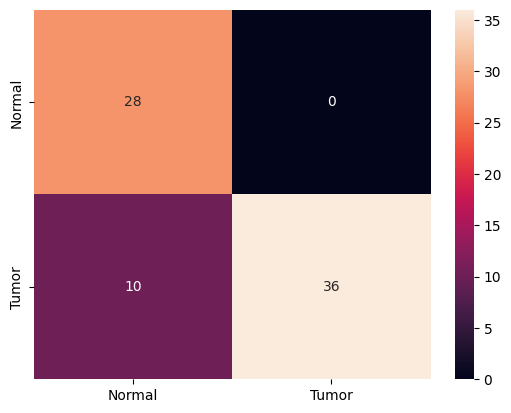

In [ ]:
cm=confusion_matrix(etiquetas,predicoes_Alex)
sns.heatmap(cm,annot=True,fmt="g",xticklabels=['Normal','Tumor'],yticklabels=['Normal','Tumor'])

In [ ]:
%tensorboard --logdir logs/fitAlex

Reusing TensorBoard on port 6006 (pid 37979), started 1:44:32 ago. (Use '!kill 37979' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
score=model_Alex.evaluate(dadosProva,DiagnosticoProva)
score[1]*100

3/3 [==============================] - 2s 344ms/step - loss: 0.2865 - accuracy: 0.8649


86.48648858070374

In [ ]:
!kill 37979

In [ ]:
history_Alex2=model_Alex2.fit(dados_train_gerados2,
          epochs=29, #Ajustar a partir del tensorboard
          validation_data=(val_data,val_labels),
          validation_freq=1,
          steps_per_epoch=Alex_train_steps)

Epoch 1/29
15/15 [==============================] - 26s 2s/step - loss: 0.0311 - accuracy: 0.9867 - val_loss: 0.5189 - val_accuracy: 0.8243
Epoch 2/29
15/15 [==============================] - 26s 2s/step - loss: 0.0212 - accuracy: 0.9733 - val_loss: 0.5053 - val_accuracy: 0.8378
Epoch 3/29
15/15 [==============================] - 26s 2s/step - loss: 0.0207 - accuracy: 0.9867 - val_loss: 0.5970 - val_accuracy: 0.7973
Epoch 4/29
15/15 [==============================] - 24s 2s/step - loss: 0.0254 - accuracy: 0.9733 - val_loss: 0.5101 - val_accuracy: 0.8243
Epoch 5/29
15/15 [==============================] - 26s 2s/step - loss: 0.0208 - accuracy: 0.9733 - val_loss: 0.6160 - val_accuracy: 0.7703
Epoch 6/29
15/15 [==============================] - 26s 2s/step - loss: 0.0280 - accuracy: 0.9700 - val_loss: 0.3355 - val_accuracy: 0.9054
Epoch 7/29
15/15 [==============================] - 25s 2s/step - loss: 0.0188 - accuracy: 0.9667 - val_loss: 0.6249 - val_accuracy: 0.7838
Epoch 8/29
15/15 [==

4/4 [==============================] - 2s 438ms/step
              precision    recall  f1-score   support

           0       0.74      1.00      0.85        28
           1       1.00      0.78      0.88        46

    accuracy                           0.86        74
   macro avg       0.87      0.89      0.86        74
weighted avg       0.90      0.86      0.87        74



<Axes: >

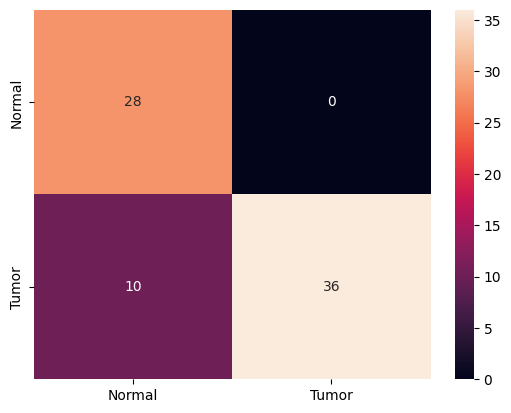

In [ ]:
predicoes_Alex2=model_Alex2.predict(dadosProva,batch_size=tamanho)
predicoes_Alex2=np.argmax(predicoes_Alex2,axis=-1)


#Diagnosticos originais
etiquetas=np.argmax(DiagnosticoProva,axis=-1)

print(classification_report(etiquetas,predicoes_Alex2))
cm=confusion_matrix(etiquetas,predicoes_Alex2)
sns.heatmap(cm,annot=True,fmt="g",xticklabels=['Normal','Tumor'],yticklabels=['Normal','Tumor'])

## ***Xception***

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.xception import Xception
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

## ***GoogleNet***

In [ ]:
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras import regularizers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.layers import Conv2D, MaxPooling2D, AveragePooling2D, ZeroPadding2D
from tensorflow.keras.layers import Concatenate
from tensorflow.keras.optimizers import Adam, SGD
import pandas as pd


In [ ]:
Train=[]

for img in dados.Imagens:
  image = cv2.convertScaleAbs(img)
  print("Tipo de dato de la imagen:", image.dtype)
  Train.append(image)

Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de dato de la imagen: uint8
Tipo de da

In [ ]:
# create model
def inception(x, filters):
    # 1x1
    path1 = Conv2D(filters=filters[0], kernel_size=(1,1), strides=1, padding='same', activation='relu')(x)

    # 1x1->3x3
    path2 = Conv2D(filters=filters[1][0], kernel_size=(1,1), strides=1, padding='same', activation='relu')(x)
    path2 = Conv2D(filters=filters[1][1], kernel_size=(3,3), strides=1, padding='same', activation='relu')(path2)

    # 1x1->5x5
    path3 = Conv2D(filters=filters[2][0], kernel_size=(1,1), strides=1, padding='same', activation='relu')(x)
    path3 = Conv2D(filters=filters[2][1], kernel_size=(5,5), strides=1, padding='same', activation='relu')(path3)

    # 3x3->1x1
    path4 = MaxPooling2D(pool_size=(3,3), strides=1, padding='same')(x)
    path4 = Conv2D(filters=filters[3], kernel_size=(1,1), strides=1, padding='same', activation='relu')(path4)

    return Concatenate(axis=-1)([path1,path2,path3,path4])


def auxiliary(x, name=None):
    layer = AveragePooling2D(pool_size=(5,5), strides=3, padding='valid')(x)
    layer = Conv2D(filters=128, kernel_size=(1,1), strides=1, padding='same', activation='relu')(layer)
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu',kernel_regularizer=regularizers.l2(0.0001))(layer)
    layer = Dropout(0.5)(layer)
    layer = Dense(units=CLASS_NUM, activation='softmax', name=name)(layer)
    return layer


def googlenet():
    layer_in = Input(shape=IMAGE_SHAPE)

    # stage-1
    layer = Conv2D(filters=64, kernel_size=(7,7), strides=2, padding='same', activation='relu')(layer_in)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)
    layer = BatchNormalization()(layer)

    # stage-2
    layer = Conv2D(filters=64, kernel_size=(1,1), strides=1, padding='same', activation='relu')(layer)
    layer = Conv2D(filters=192, kernel_size=(3,3), strides=1, padding='same', activation='relu')(layer)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    # stage-3
    layer = inception(layer, [ 64,  (96,128), (16,32), 32]) #3a
    layer = inception(layer, [128, (128,192), (32,96), 64]) #3b
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    # stage-4
    layer = inception(layer, [192,  (96,208),  (16,48),  64]) #4a
    aux1  = auxiliary(layer, name='aux1')
    layer = inception(layer, [160, (112,224),  (24,64),  64]) #4b
    layer = inception(layer, [128, (128,256),  (24,64),  64]) #4c
    layer = inception(layer, [112, (144,288),  (32,64),  64]) #4d
    aux2  = auxiliary(layer, name='aux2')
    layer = inception(layer, [256, (160,320), (32,128), 128]) #4e
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    # stage-5
    layer = inception(layer, [256, (160,320), (32,128), 128]) #5a
    layer = inception(layer, [384, (192,384), (48,128), 128]) #5b
    layer = AveragePooling2D(pool_size=(7,7), strides=1, padding='valid')(layer)

    # stage-6
    layer = Flatten()(layer)
    layer = Dropout(0.5)(layer)
    layer = Dense(units=256, activation='linear',kernel_regularizer=regularizers.l2(0.0001))(layer)
    main = Dense(units=CLASS_NUM, activation='softmax', name='main')(layer)

    model = Model(inputs=layer_in, outputs=[main, aux1, aux2])

    return model

In [ ]:
"""
data_train = []

for i in dados.Imagens:
    image=cv2.cvtColor(i,cv2.COLOR_GRAY2RGB)
    image=cv2.resize(image,(224,224))
    image=np.array(image)
    data_train.append(image)

labels_train = dados.Diagnostico
"""
data_train = []

for i in Train:
    image=cv2.cvtColor(i,cv2.COLOR_GRAY2RGB)
    image=cv2.resize(image,(224,224))
    image=np.array(image)
    data_train.append(image)

labels_train = dados.Diagnostico

In [ ]:
data_train = np.array(data_train)
labels_train = np.array(labels_train)
data_train.shape

(218, 224, 224, 3)

In [ ]:
etiquetas_train=np.zeros(len(labels_train))

for i in range(len(labels_train)):
  if labels_train[i]=="TUMOR":
    etiquetas_train[i]=1
  else :
    etiquetas_train[i]=0

In [ ]:
data_train=data_train/255

In [ ]:
CLASS_NUM = 2
BATCH_SIZE = 20
EPOCH_STEPS = int(data_train.shape[0]*2/BATCH_SIZE)
IMAGE_SHAPE = (224, 224, 3)
MODEL_NAME = 'googlenet_brain'

In [ ]:
root_logdir = os.path.join(os.curdir, "logs/fitGoogle/")
run_logdir = get_run_logdir(root_logdir)
tensorboard_Google = kr.callbacks.TensorBoard(run_logdir)

In [ ]:
# train model
model = googlenet()
model.summary()
#model.load_weights(MODEL_NAME)
tf.keras.utils.plot_model(model, 'GoogLeNet.png')

optimizer = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-08)
#optimizer = SGD(learning_rate=1 * 1e-1, momentum=0.9, nesterov=True)
#model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=['accuracy'])
#es = EarlyStopping(monitor='val_loss', mode='min', verbose=1)
optimizer = ['Adam', 'SGD', 'Adam', 'SGD']
epochs = [20, 30, 20, 30]
history_all = {}


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_10 (Conv2D)             (None, 112, 112, 64  9472        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 max_pooling2d_6 (MaxPooling2D)  (None, 56, 56, 64)  0           ['conv2d_10[0][0]']              
                                                                                              

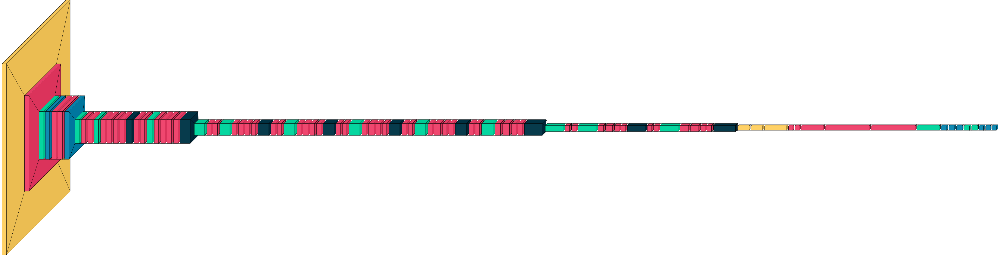

In [ ]:
visualkeras.layered_view(model)

In [ ]:
history = model.fit(data_train,etiquetas_train,
                    epochs=30,
                    steps_per_epoch=EPOCH_STEPS,
                    callbacks=[tensorboard_Google],
                    validation_data=(dadosProva,etiquetas)
                    )

model.save(MODEL_NAME)

Epoch 1/30
21/21 [==============================] - 94s 4s/step - loss: 3.2191 - main_loss: 1.1569 - aux1_loss: 1.1649 - aux2_loss: 0.7862 - main_accuracy: 0.5022 - aux1_accuracy: 0.5590 - aux2_accuracy: 0.5022 - val_loss: 2.1844 - val_main_loss: 0.6981 - val_aux1_loss: 0.6959 - val_aux2_loss: 0.6940 - val_main_accuracy: 0.3784 - val_aux1_accuracy: 0.3784 - val_aux2_accuracy: 0.3784
Epoch 2/30
21/21 [==============================] - 76s 4s/step - loss: 2.1501 - main_loss: 0.6972 - aux1_loss: 0.6683 - aux2_loss: 0.6940 - main_accuracy: 0.5459 - aux1_accuracy: 0.5983 - aux2_accuracy: 0.5677 - val_loss: 2.1425 - val_main_loss: 0.7004 - val_aux1_loss: 0.6670 - val_aux2_loss: 0.6889 - val_main_accuracy: 0.3784 - val_aux1_accuracy: 0.6216 - val_aux2_accuracy: 0.7027
Epoch 3/30
21/21 [==============================] - 73s 3s/step - loss: 2.0804 - main_loss: 0.6849 - aux1_loss: 0.6383 - aux2_loss: 0.6730 - main_accuracy: 0.4934 - aux1_accuracy: 0.6463 - aux2_accuracy: 0.5808 - val_loss: 2.081

21/21 [==============================] - 42s 2s/step - loss: 0.5380 - main_loss: 0.2049 - aux1_loss: 0.1708 - aux2_loss: 0.1019 - main_accuracy: 0.9231 - aux1_accuracy: 0.9385 - aux2_accuracy: 0.9692 - val_loss: 1.3159 - val_main_loss: 0.4430 - val_aux1_loss: 0.3514 - val_aux2_loss: 0.4612 - val_main_accuracy: 0.8108 - val_aux1_accuracy: 0.8243 - val_aux2_accuracy: 0.8378


In [ ]:
score = model.evaluate(dadosProva, etiquetas)
print('Score:', score[4])

3/3 [==============================] - 4s 1s/step - loss: 1.3159 - main_loss: 0.4430 - aux1_loss: 0.3514 - aux2_loss: 0.4612 - main_accuracy: 0.8108 - aux1_accuracy: 0.8243 - aux2_accuracy: 0.8378
Score: 0.8108108043670654


In [ ]:
%tensorboard --logdir logs/fitGoogle

<IPython.core.display.Javascript object>

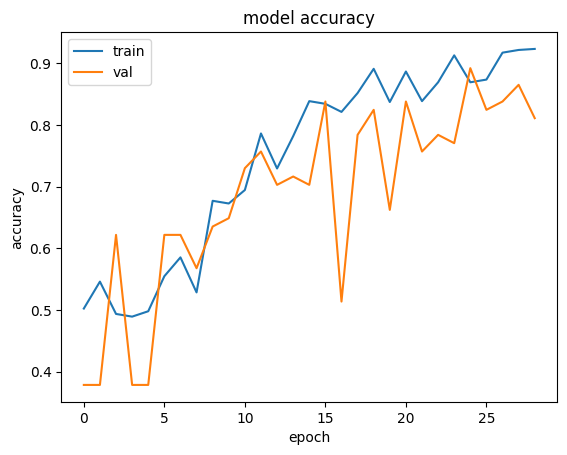

In [ ]:
plt.plot(history.history['main_accuracy'])
plt.plot(history.history['val_main_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

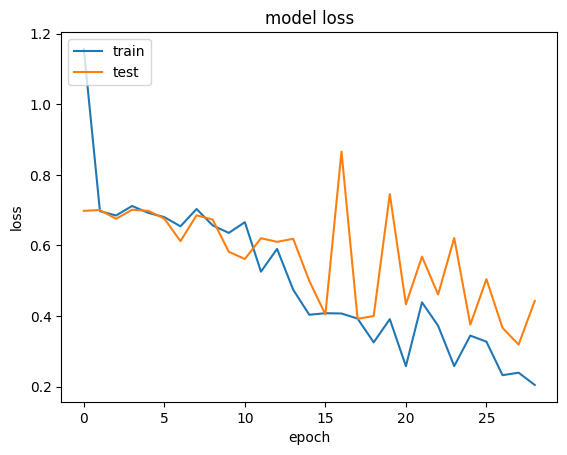

In [ ]:
plt.plot(history.history['main_loss'])
plt.plot(history.history['val_main_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

4/4 [==============================] - 7s 1s/step
              precision    recall  f1-score   support

           0       0.68      0.96      0.79        28
           1       0.97      0.72      0.82        46

    accuracy                           0.81        74
   macro avg       0.82      0.84      0.81        74
weighted avg       0.86      0.81      0.81        74



<Axes: >

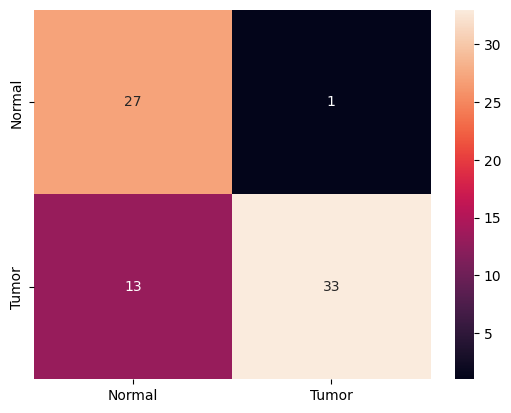

In [ ]:
predicoes_Google=model.predict(dadosProva,batch_size=tamanho)
predicoes_Google=np.argmax(predicoes_Google[0],axis=-1)


#Diagnosticos originais
etiquetas=np.argmax(DiagnosticoProva,axis=-1)

print(classification_report(etiquetas,predicoes_Google))
cm=confusion_matrix(etiquetas,predicoes_Google)
sns.heatmap(cm,annot=True,fmt="g",xticklabels=['Normal','Tumor'],yticklabels=['Normal','Tumor'])

In [ ]:
etiquetas

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1])

In [ ]:
predicoes_Google=model.predict(dadosProva,batch_size=tamanho)
predicoes_Google=np.argmax(predicoes_Google[0],axis=-1)
#Diagnosticos originais
predicoes_Google

4/4 [==============================] - 8s 2s/step


array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0,
       0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1,
       1, 0, 1, 0, 1, 1, 0, 1])

In [ ]:
etiquetas

# ***GoogleNet***

In [ ]:
import os
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras import regularizers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.layers import Conv2D, MaxPooling2D, AveragePooling2D, ZeroPadding2D
from tensorflow.keras.layers import Concatenate
from tensorflow.keras.optimizers import Adam, SGD
import pandas as pd


In [ ]:
# create model
def inception(x, filters):
    # 1x1
    path1 = Conv2D(filters=filters[0], kernel_size=(1,1), strides=1, padding='same', activation='relu')(x)

    # 1x1->3x3
    path2 = Conv2D(filters=filters[1][0], kernel_size=(1,1), strides=1, padding='same', activation='relu')(x)
    path2 = Conv2D(filters=filters[1][1], kernel_size=(3,3), strides=1, padding='same', activation='relu')(path2)

    # 1x1->5x5
    path3 = Conv2D(filters=filters[2][0], kernel_size=(1,1), strides=1, padding='same', activation='relu')(x)
    path3 = Conv2D(filters=filters[2][1], kernel_size=(5,5), strides=1, padding='same', activation='relu')(path3)

    # 3x3->1x1
    path4 = MaxPooling2D(pool_size=(3,3), strides=1, padding='same')(x)
    path4 = Conv2D(filters=filters[3], kernel_size=(1,1), strides=1, padding='same', activation='relu')(path4)

    return Concatenate(axis=-1)([path1,path2,path3,path4])


def auxiliary(x, name=None):
    layer = AveragePooling2D(pool_size=(5,5), strides=3, padding='valid')(x)
    layer = Conv2D(filters=128, kernel_size=(1,1), strides=1, padding='same', activation='relu')(layer)
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu',kernel_regularizer=regularizers.l2(0.0001))(layer)
    layer = Dropout(0.5)(layer)
    layer = Dense(units=CLASS_NUM, activation='softmax', name=name)(layer)
    return layer


def googlenet():
    layer_in = Input(shape=IMAGE_SHAPE)

    # stage-1
    layer = Conv2D(filters=64, kernel_size=(7,7), strides=2, padding='same', activation='relu')(layer_in)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)
    layer = BatchNormalization()(layer)

    # stage-2
    layer = Conv2D(filters=64, kernel_size=(1,1), strides=1, padding='same', activation='relu')(layer)
    layer = Conv2D(filters=192, kernel_size=(3,3), strides=1, padding='same', activation='relu')(layer)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    # stage-3
    layer = inception(layer, [ 64,  (96,128), (16,32), 32]) #3a
    layer = inception(layer, [128, (128,192), (32,96), 64]) #3b
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    # stage-4
    layer = inception(layer, [192,  (96,208),  (16,48),  64]) #4a
    aux1  = auxiliary(layer, name='aux1')
    layer = inception(layer, [160, (112,224),  (24,64),  64]) #4b
    layer = inception(layer, [128, (128,256),  (24,64),  64]) #4c
    layer = inception(layer, [112, (144,288),  (32,64),  64]) #4d
    aux2  = auxiliary(layer, name='aux2')
    layer = inception(layer, [256, (160,320), (32,128), 128]) #4e
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    # stage-5
    layer = inception(layer, [256, (160,320), (32,128), 128]) #5a
    layer = inception(layer, [384, (192,384), (48,128), 128]) #5b
    layer = AveragePooling2D(pool_size=(7,7), strides=1, padding='valid')(layer)

    # stage-6
    layer = Flatten()(layer)
    layer = Dropout(0.5)(layer)
    layer = Dense(units=256, activation='linear',kernel_regularizer=regularizers.l2(0.0001))(layer)
    main = Dense(units=CLASS_NUM, activation='softmax', name='main')(layer)

    model = Model(inputs=layer_in, outputs=[main, aux1, aux2])

    return model

In [ ]:
data_train = []

for i in dados.Imagens:
  i=cv2.ab
    image=cv2.cvtColor(i,cv2.COLOR_GRAY2RGB)
    image=cv2.resize(image,(224,224))
    image=np.array(image)
    data_train.append(image)

labels_train = dados.Diagnostico

error: ignored

In [ ]:
data_train = np.array(data_train)
labels_train = np.array(labels_train)
data_train.shape

NameError: ignored

In [ ]:
etiquetas_train=np.zeros(len(labels_train))

for i in range(len(labels_train)):
  if labels_train[i]=="TUMOR":
    etiquetas_train[i]=1
  else :
    etiquetas_train[i]=0

In [ ]:
data_train=data_train/255

In [ ]:
CLASS_NUM = 2
BATCH_SIZE = 20
EPOCH_STEPS = int(data_train.shape[0]*2/BATCH_SIZE)
IMAGE_SHAPE = (224, 224, 3)
MODEL_NAME = 'googlenet_brain'

In [ ]:
# train model
model = googlenet()
model.summary()
#model.load_weights(MODEL_NAME)
tf.keras.utils.plot_model(model, 'GoogLeNet.png')

optimizer = Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-08)
#optimizer = SGD(lr=1 * 1e-1, momentum=0.9, nesterov=True)
#model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=['accuracy'])
#es = EarlyStopping(monitor='val_loss', mode='min', verbose=1)
optimizer = ['Adam', 'SGD', 'Adam', 'SGD']
epochs = [20, 30, 20, 30]
history_all = {}

history = model.fit(data_train,etiquetas_train,epochs=30,steps_per_epoch=EPOCH_STEPS,validation_data=(dadosProva,etiquetas))

model.save(MODEL_NAME)

In [ ]:
score = model.evaluate(dadosProva, etiquetas)
print('Score:', score[4])

In [ ]:
plt.plot(history.history['main_accuracy'])
plt.plot(history.history['val_main_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

In [ ]:
plt.plot(history.history['main_loss'])
plt.plot(history.history['val_main_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

##***ResNet***

In [ ]:
# Definir el bloque básico de la ResNet
class BasicBlock(nn.Module):
    expansion = 1

    def __init__(self, in_channels, out_channels, stride=1):
        super(BasicBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)

        self.shortcut = nn.Sequential()
        if stride != 1 or in_channels != self.expansion * out_channels:
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_channels, self.expansion * out_channels, kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(self.expansion * out_channels)
            )

    def forward(self, x):
        residual = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)

        out += self.shortcut(residual)
        out = self.relu(out)

        return out

# Definir la arquitectura ResNet
class ResNet(nn.Module):
    def __init__(self, block, num_blocks, num_classes=1000):
        super(ResNet, self).__init__()
        self.in_channels = 64

        self.conv1 = nn.Conv2d(3, 64, kernel_size=7, stride=2, padding=3, bias=False)
        self.bn1 = nn.BatchNorm2d(64)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)

        self.layer1 = self._make_layer(block, 64, num_blocks[0], stride=1)
        self.layer2 = self._make_layer(block, 128, num_blocks[1], stride=2)
        self.layer3 = self._make_layer(block, 256, num_blocks[2], stride=2)
        self.layer4 = self._make_layer(block, 512, num_blocks[3], stride=2)

        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(512 * block.expansion, num_classes)

    def _make_layer(self, block, out_channels, num_blocks, stride):
        strides = [stride] + [1] * (num_blocks - 1)
        layers = []
        for stride in strides:
            layers.append(block(self.in_channels, out_channels, stride))
            self.in_channels = out_channels * block.expansion
        return nn.Sequential(*layers)

    def forward(self, x):
        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)
        out = self.maxpool(out)

        out = self.layer1(out)
        out = self.layer2(out)
        out = self.layer3(out)
        out = self.layer4(out)

        out = self.avgpool(out)
        out = torch.flatten(out, 1)
        out = self.fc(out)

        return out

# Crear una instancia de la arquitectura ResNet
resnet = ResNet(BasicBlock, [2, 2, 2, 2])

#ResNet18

In [ ]:
import cv2
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder

# Definir transformaciones de datos para normalizar y redimensionar las imágenes
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Cargar los datos de entrenamiento y prueba
train_dataset = ImageFolder("/content/drive/MyDrive/Entrenamiento/", transform=transform)#Debo cambiar esto
test_dataset = ImageFolder('/content/drive/MyDrive/Prueba', transform=transform)#Debo cambiar esto

#___________________________________________________________________________________________________________________________________
# Definir DataLoader para facilitar el manejo de los datos

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)


class ResNet(nn.Module):
    def __init__(self, num_classes):
        super(ResNet, self).__init__()
        self.resnet = torchvision.models.resnet18(pretrained=True)
        self.resnet.fc = nn.Linear(512, num_classes)

    def forward(self, x):
        return self.resnet(x)

# Crear una instancia del modelo ResNet
model = ResNet(num_classes=2)

#T de entrenamiento
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)


num_epochs = 10

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0

    for images, labels in train_loader:
        images = images.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()

        outputs = model(images)
        loss = criterion(outputs, labels)

        loss.backward()
        optimizer.step()

        running_loss += loss.item() * images.size(0)

    epoch_loss = running_loss / len(train_dataset)
    print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {epoch_loss:.4f}")


    model.eval()
correct = 0
total = 0

with torch.no_grad():
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)

        outputs = model(images)
        _, predicted = torch.max(outputs.data, 1)

        total += labels.size(0)
        correct += (predicted == labels).sum().item()

accuracy = correct / total
print(f"Accuracy on test set: {accuracy:.4f}")

Error while opening the image: cannot identify image file '/content/drive/MyDrive/Entrenamiento/no_artificial/197.jpg'


UnidentifiedImageError: ignored